In [1]:
import gradio as gr
import numpy as np
import IPython
from IPython.display import Audio, display
import torch
import librosa, librosa.display
from tqdm import tqdm
from stqdm import stqdm
import json

# import sys  
# sys.path.insert(0, '../')
from audioldm2 import text_to_audio, build_model, seed_everything, make_batch_for_text_to_audio
from audioldm2.latent_diffusion.modules.diffusionmodules.util import (
    make_ddim_sampling_parameters,
    make_ddim_timesteps,
    noise_like,
    extract_into_tensor,
)
from audioldm2.latent_diffusion.models.ddim import DDIMSampler
from audioldm2.utilities import *
from audioldm2.utilities.audio import *
from audioldm2.utilities.data import *
from audioldm2.utils import default_audioldm_config

from audioldm2.gaverutils import gaver_sounds

from audioldm2.latent_diffusion.modules.attention import SpatialTransformer, CrossAttention

from einops import rearrange, repeat


%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [3]:
%reload_ext autoreload

In [4]:
%matplotlib inline

In [5]:
import warnings

def fxn():
    warnings.warn("deprecated", DeprecationWarning)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()


In [6]:
audioldm = None
current_model_name = None

model_name = 'audioldm_16k_crossattn_t5' # doesnt work very well? But the only thing that fits on my machine
# model_name = 'audioldm2-full' # Attention re-weighting does not work with MAE. MAE alters the embedding through a linear layer. We loose token level info.
# model_name = 'audioldm_48k'

latent_diffusion=build_model(model_name=model_name)

Loading AudioLDM-2: audioldm_16k_crossattn_t5
Loading model on cuda:0
{'variables': {'sampling_rate': 16000, 'mel_bins': 64, 'latent_embed_dim': 8, 'latent_t_size': 256, 'latent_f_size': 16, 'in_channels': 8, 'optimize_ddpm_parameter': True, 'warmup_steps': 5000}, 'step': {'validation_every_n_epochs': 1, 'save_checkpoint_every_n_steps': 5000, 'max_steps': 1500000, 'save_top_k': 2}, 'preprocessing': {'audio': {'sampling_rate': 16000, 'max_wav_value': 32768, 'duration': 10.24}, 'stft': {'filter_length': 1024, 'hop_length': 160, 'win_length': 1024}, 'mel': {'n_mel_channels': 64, 'mel_fmin': 0, 'mel_fmax': 8000}}, 'augmentation': {'mixup': 0}, 'model': {'target': 'audioldm2.latent_diffusion.models.ddpm.LatentDiffusion', 'params': {'first_stage_config': {'base_learning_rate': 8e-06, 'target': 'audioldm2.latent_encoder.autoencoder.AutoencoderKL', 'params': {'sampling_rate': 16000, 'batchsize': 4, 'monitor': 'val/rec_loss', 'image_key': 'fbank', 'subband': 1, 'embed_dim': 8, 'time_shuffle': 1

/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torchaudio/transforms/_transforms.py:580: UserWarning: Argument 'onesided' has been deprecated and has no influence on the behavior of this module.
  warnings.warn(


DiffusionWrapper has 265.53 M params.


/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torch/nn/utils/weight_norm.py:28: UserWarning: torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.
  warnings.warn("torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.")


In [7]:
latent_t_per_second=25.6
sample_rate=16000
duration = 10.0 #Duration is minimum 10 secs. The generated sounds are weird for <10secs
guidance_scale = 3
random_seed = 43
n_candidates = 1
batch_size = 1
ddim_steps = 20

fbank = torch.zeros((batch_size, 1024, 64))
stft = torch.zeros((batch_size, 1024, 512))
waveform = torch.zeros((batch_size, 160000))

seed_everything(int(random_seed))
x_T = torch.randn((1, 8, 256, 16), device="cuda")

latent_diffusion.latent_t_size = int(duration * latent_t_per_second)

In [8]:
def plot(waveform, predicted_noise, predicted_uncond_noise):
    epsilon_noise = noise_to_mel_to_wave(predicted_noise)
    epsilon_noise_uncond = noise_to_mel_to_wave(predicted_uncond_noise)
    
    IPython.display.display(IPython.display.Audio(waveform[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(epsilon_noise[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(epsilon_noise_uncond[0][0], rate=16000))
    
    %matplotlib inline
    
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15,5))
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(waveform[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(epsilon_noise[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(epsilon_noise_uncond[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[2])
    
    torch.norm(predicted_noise), torch.norm(predicted_uncond_noise)

def plot_wavs(wav1, wav2):
    IPython.display.display(IPython.display.Audio(wav1[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(wav2[0][0], rate=16000))

    %matplotlib inline
    
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(wav1[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
    axs[0].set_title('wav1') 
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(wav2[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
    axs[1].set_title('wav2') 

def plot_all(wavs):
    %matplotlib inline
    nrows = len(wavs)//4 
    if len(wavs)%4 > 0:
        nrows += 1
    print('num rows=', nrows)
    fig, axs = plt.subplots(nrows=nrows, ncols=4, figsize=(15,5))
    for i, wav in enumerate(wavs):
        nrow = i//4
        ncol = i%4
        IPython.display.display(IPython.display.Audio(wav[0][0], rate=16000))

        D = librosa.amplitude_to_db(np.abs(librosa.stft(wav[0][0], hop_length=512)),ref=np.max)
        if nrows>1:
            librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[nrow][ncol])
        else:
            librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[ncol])

def noise_to_mel_to_wave(predicted_noise):
    mel = latent_diffusion.decode_first_stage(predicted_noise)
    waveform = latent_diffusion.mel_spectrogram_to_waveform(
        mel, savepath="", bs=None, name="somename", save=False
    )
    return waveform

In [9]:
class SaveAttentionMatrices:
    def __init__(self):
        self.attention = []
        self.q = []
        self.k = []
        self.v = []
    def __call__(self, module, module_in, module_out):
        ret = module_out[1]
        attn = None
        q = None
        k = None
        v = None
        if ret is not None:
            attn = ret['attn'].detach().cpu()
            q = ret['q'].detach().cpu()
            k = ret['k'].detach().cpu()
            v = ret['v'].detach().cpu()
        self.attention.append(attn)
        self.q.append(q)
        self.k.append(k)
        self.v.append(v)
            
    def clear(self):
        self.attention = []
        self.q = []
        self.k = []
        self.v = []

def clear_attention_matrices(save_output):
    save_output.clear()
    
def register_save_attention(latent_diffusion, save_output):
    save_attention_hook_handles = []
    save_attention_hook_layer_names = []
    for n, m in latent_diffusion.named_modules():
        if(isinstance(m, CrossAttention)):
            if 'attn2' in n:
                handle = m.register_forward_hook(save_output)
                save_attention_hook_handles.append(handle)
                save_attention_hook_layer_names.append(n)
    return save_attention_hook_handles, save_attention_hook_layer_names

def unregister_save_attention(save_attention_hook_handles):
    for handle in save_attention_hook_handles:
        handle.remove()


In [10]:
# Clone and return only the conditional attention matrices
def clone_attention_matrices(save_output): 
    cloned_attention = []
    cloned_q = []
    cloned_k = []
    cloned_v = []
    for attn in save_output.attention:
        if attn is not None:
            cloned_attention.append(attn.clone().detach())
        else:
            cloned_attention.append(None)

    for q in save_output.q:
        if q is not None:
            cloned_q.append(q.clone().detach())
        else:
            cloned_q.append(None)

    for k in save_output.k:
        if k is not None:
            cloned_k.append(k.clone().detach())
        else:
            cloned_k.append(None)

    for v in save_output.v:
        if v is not None:
            cloned_v.append(v.clone().detach())
        else:
            cloned_v.append(None)
    
    return cloned_attention, cloned_q, cloned_k, cloned_v

In [11]:
#simple one to one implementation
def get_tokens(latent_diffusion, source_text, dest_text, source_word_index=None):
    source_tokens = latent_diffusion.cond_stage_models\
    [latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(source_text)

    dest_tokens = latent_diffusion.cond_stage_models\
    [latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(dest_text)
    print(source_tokens, dest_tokens)

    if source_word_index is None:
        return source_tokens, dest_tokens
    else:
        return [source_tokens[source_word_index]], [dest_tokens[source_word_index]]

In [12]:
class EditAttentionMatrices:
    def __init__(self, layer_name, save_attention_hook_layer_names):
        self.layer_name = layer_name
        self.save_attention_hook_layer_names = save_attention_hook_layer_names

    def __call__(self, module, module_in, kwargs):
        attention_weights = None
        
        if 'attention_weights' in kwargs and kwargs['attention_weights'] is not None:
            attention_weights = kwargs['attention_weights']

            timestep = attention_weights['timestep'] #set in the sample_diffusion func
            layer_id = self.save_attention_hook_layer_names.index(self.layer_name)

            # print(layer_id, self.layer_name)
            # print(layer_id, '|', len(attention_weights['source_attn']), '|', len(attention_weights['source_q']))
            # print("Length of source_attn",self.layer_name, len(attention_weights['source_attn']), attention_weights['source_attn'][layer_id].shape, attention_weights['target_attn'][layer_id].shape)
            # print("Length of source_q",self.layer_name, len(attention_weights['source_q']), attention_weights['source_q'][layer_id].shape, attention_weights['target_q'][layer_id].shape)
            # print("Length of source_k",self.layer_name, len(attention_weights['source_k']), attention_weights['source_k'][layer_id].shape, attention_weights['target_k'][layer_id].shape)
            # print("Length of source_v",self.layer_name, len(attention_weights['source_v']), attention_weights['source_v'][layer_id].shape, attention_weights['target_v'][layer_id].shape)

            interpolation_level = attention_weights['interpolation_level']

            source_idxs = attention_weights['source_tokens']
            dest_idxs = attention_weights['target_tokens']


            source_q = attention_weights['source_q'][layer_id]
            target_q = attention_weights['target_q'][layer_id]

            source_k_list = []
            source_v_list = []
            target_k_list = []
            target_v_list = []
            for ind, dest_idx in enumerate(dest_idxs): #[[0], [1, 3], [4], [5], [6], [7, 8], [9]]
                source_idx = source_idxs[ind]
                
                source_k_ = torch.mean(attention_weights['source_k'][layer_id][:,source_idx[0]:source_idx[-1]+1, :], dim=-2).cuda()
                source_v_ = torch.mean(attention_weights['source_v'][layer_id][:,source_idx[0]:source_idx[-1]+1, :], dim=-2).cuda()

                for dest_idx_ in range(dest_idx[0],dest_idx[-1]+1):
                    source_k_list.append(source_k_)
                    source_v_list.append(source_v_)
                    
                    target_k_ = attention_weights['target_k'][layer_id][:,dest_idx_, :].cuda()
                    target_v_ = attention_weights['target_v'][layer_id][:,dest_idx_, :].cuda()
                    target_k_list.append(target_k_)
                    target_v_list.append(target_v_)

            source_k_list.append(attention_weights['source_k'][layer_id][:,-1,:].cuda())
            source_v_list.append(attention_weights['source_v'][layer_id][:,-1,:].cuda())
            target_k_list.append(attention_weights['target_k'][layer_id][:,-1,:].cuda())
            target_v_list.append(attention_weights['target_v'][layer_id][:,-1,:].cuda())

            
            

                # print(attention_weights['source_k'][layer_id].shape, len(source_k_list), source_k_.shape, source_v_.shape, target_k_.shape, target_v_.shape)

            source_k_list = rearrange(torch.stack(source_k_list), 'b i j -> i b j')
            source_v_list = rearrange(torch.stack(source_v_list), 'b i j -> i b j')
            target_k_list = rearrange(torch.stack(target_k_list), 'b i j -> i b j')
            target_v_list = rearrange(torch.stack(target_v_list), 'b i j -> i b j')
            # print(source_k_list.shape, source_v_list.shape, target_k_list.shape, target_v_list.shape)
            # print(attention_weights['target_k'][layer_id].shape, attention_weights['target_v'][layer_id].shape)
            # print(attention_weights['source_k'][layer_id].shape, attention_weights['source_v'][layer_id].shape)
            
            # source_q = attention_weights['source_q'][layer_id]
            # source_k = attention_weights['source_k'][layer_id]
            # source_v = attention_weights['source_v'][layer_id]

            # # target_q = attention_weights['target_q'][layer_id]
            # target_k = attention_weights['target_k'][layer_id]
            # target_v = attention_weights['target_v'][layer_id]

            # print(source_q.shape, target_q.shape)
            # print(source_k.shape, target_k.shape)

            final_q = (1-interpolation_level) * source_q + interpolation_level*target_q
            final_k = (1-interpolation_level) * source_k_list + interpolation_level*target_k_list
            final_v = (1-interpolation_level) * source_v_list + interpolation_level*target_v_list

            attention_weights['q'] = final_q.cuda()
            attention_weights['k'] = final_k.cuda()
            attention_weights['v'] = final_v.cuda()
            # print('--',attention_weights['q'].shape, attention_weights['k'].shape, attention_weights['v'].shape)
            
            
            # attention_weights_interpolates = []
            # attention_weights_interpolates_idx = []

            # source_idxs = attention_weights['source_tokens']
            # dest_idxs = attention_weights['target_tokens']

            # edit_level = attention_weights['interpolates_mult']

            # # cond_timestep_attention_matrices = attention_weights['attention_matrix']
            # source_attention_matrices = attention_weights['source_attention_matrices']
            # target_attention_matrices = attention_weights['target_attention_matrices']
            # for source_idx, dest_idx in zip(source_idxs, dest_idxs):
            #     final_matrices = None
            #     # 1. if source_idx is list and dest_idx is not list
            #     if type(source_idx) == list and type(dest_idx) != list:
            #         # print('here1')
            #         source_matrices_mean = torch.mean(source_attention_matrices[layer_id][:,:,source_idx[0]:source_idx[-1]+1], dim=-1).cuda()
            #         target_matrices = target_attention_matrices[layer_id][:,:,dest_idx].cuda()
            #         final_matrices = (1-edit_level) * target_matrices + edit_level * source_matrices_mean

            #     # 2. if source_idx is not list and dest_idx is list
            #     if type(source_idx) != list and type(dest_idx) == list:
            #         # print('here2')
            #         source_matrices = source_attention_matrices[layer_id][:,:,source_idx].cuda()
            #         target_matrices = torch.mean(target_attention_matrices[layer_id][:,:,dest_idx[0]:dest_idx[-1]+1], dim=-1).cuda()
            #         final_matrices = (1-edit_level) * target_matrices + edit_level * source_matrices_mean
                    
            #     # 3. if both source_idx and dest_idx are not lists
            #     if type(source_idx) != list and type(dest_idx) != list:
            #         # print('here3')
            #         source_matrices = source_attention_matrices[layer_id][:,:,source_idx].cuda()
            #         target_matrices = torch.mean(target_attention_matrices[layer_id][:,:,dest_idx], dim=-1).cuda()
            #         final_matrices = (1-edit_level) * target_matrices + edit_level * source_matrices_mean

            #     # 4. if both source_idx and dest_idx are lists
            #     if type(source_idx) == list and type(dest_idx) == list:
            #         # print('here34', source_idx, dest_idx)
            #         source_matrices_mean = torch.mean(source_attention_matrices[layer_id][:,:,source_idx[0]:source_idx[-1]+1], dim=-1).cuda()
            #         target_matrices = torch.mean(target_attention_matrices[layer_id][:,:,dest_idx[0]:dest_idx[-1]+1], dim=-1).cuda()
            #         final_matrices = (1-edit_level) * target_matrices + edit_level * source_matrices_mean
            
                
            #     attention_weights_interpolates.append(final_matrices)
            #     attention_weights_interpolates_idx.append(dest_idx)

                
            #     attention_weights['interpolates'] = attention_weights_interpolates
            #     attention_weights['interpolates_idx'] = attention_weights_interpolates_idx
                # attention_weights['interpolates_mult'] = 0.9

        kwargs['attention_weights'] = attention_weights
        # print('kwargs::::', kwargs)
        return module_in, kwargs

In [13]:
def register_edit_attention(latent_diffusion, save_attention_hook_layer_names):
    edithook_handles = []
    for n, m in latent_diffusion.named_modules():
        if(isinstance(m, CrossAttention)):
            if 'attn2' in n:
                edit_attention = EditAttentionMatrices(layer_name=n, save_attention_hook_layer_names=save_attention_hook_layer_names)
                handle = m.register_forward_pre_hook(edit_attention, with_kwargs=True) 
                edithook_handles.append(handle)
    return edithook_handles

def unregister_edit_attention(edithook_handles):
    for handle in edithook_handles:
        handle.remove()


In [14]:
def sample_diffusion_attention_edit(latent_diffusion, source_text, target_text, batch_size=1, ddim_steps=20, \
                                    guidance_scale=3.0, random_seed=42, \
                                    interpolation_level=0.5,\
                                    source_selected_word_list=None, source_value_list=None, \
                                    target_selected_word_list=None, target_value_list=None,\
                                    interpolate_terms=['q','k','v']):

    edit_mode = False
    if source_text is not None:
        edit_mode = True
    
    with torch.no_grad():
        seed_everything(int(random_seed))
        x_init = torch.randn((1, 8, 256, 16), device="cuda")

        save_output = SaveAttentionMatrices()

        uncond_dict = {}
        for key in latent_diffusion.cond_stage_model_metadata:
            model_idx = latent_diffusion.cond_stage_model_metadata[key]["model_idx"]
            uncond_dict[key] = latent_diffusion.cond_stage_models[
                model_idx
            ].get_unconditional_condition(batch_size)

        if edit_mode:
            source_cond_batch = make_batch_for_text_to_audio(source_text, transcription="", waveform=None, batchsize=batch_size)
            _, c = latent_diffusion.get_input(source_cond_batch, latent_diffusion.first_stage_key,unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
            source_cond_dict = latent_diffusion.filter_useful_cond_dict(c)

        target_cond_batch = make_batch_for_text_to_audio(target_text, transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(target_cond_batch, latent_diffusion.first_stage_key,unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        target_cond_dict = latent_diffusion.filter_useful_cond_dict(c)

        shape = (latent_diffusion.channels, latent_diffusion.latent_t_size, latent_diffusion.latent_f_size)
        device=latent_diffusion.device
        eta=1.0
        temperature = 1.0
        noise = noise_like(x_init.shape, device, repeat=False) * temperature

        ddim_sampler = DDIMSampler(latent_diffusion, device=device)
        ddim_sampler.make_schedule(ddim_num_steps=ddim_steps, ddim_eta=eta, verbose=False)
        
        timesteps = ddim_sampler.ddim_timesteps

        time_range = np.flip(timesteps)
        total_steps = timesteps.shape[0]
        print(f"Running DDIM Sampling with {total_steps} timesteps")
        iterator = tqdm(time_range, desc="DDIM Sampler", total=total_steps)

        
        source_word_weights = {} #used only for weighting source words
        if source_selected_word_list is not None:
            word_weights = set_weight_for_word(prompt=source_text, selected_word_list=source_selected_word_list,\
                                                                value_list=source_value_list, latent_diffusion=latent_diffusion)
            source_word_weights['word_weights'] = word_weights 

        target_word_weights = {} #used only for weighting target words
        if target_selected_word_list is not None:
            word_weights = set_weight_for_word(prompt=target_text, selected_word_list=target_selected_word_list,\
                                                                value_list=target_value_list, latent_diffusion=latent_diffusion)
            target_word_weights['word_weights'] = word_weights 


        
        interpolation_attention_weights = {} #used for interpolation
        interpolation_attention_weights['interpolate_terms'] = interpolate_terms

        if edit_mode:
            source_tokens, target_tokens = get_tokens(latent_diffusion, source_text, target_text, source_word_index=None)
            # print(source_tokens, target_tokens)
            interpolation_attention_weights['source_tokens'] = source_tokens
            interpolation_attention_weights['target_tokens'] = target_tokens

        for i, step in enumerate(iterator):
            interpolation_attention_weights['timestep'] = i

            interpolation_attention_weights['interpolation_level'] = interpolation_level

            index = total_steps - i - 1
            t_in = torch.full((batch_size,), step, device=device, dtype=torch.long)

            model_uncond = ddim_sampler.model.apply_model(x_init, t_in, uncond_dict) 
            # clear_attention_matrices(save_output) # we dont need the uncond matrices

            # edithook_handles = None
            if edit_mode:

                save_attention_hook_handles, save_attention_hook_layer_names = register_save_attention(latent_diffusion, save_output)

                model_source_cond = ddim_sampler.model.apply_model(x_init, t_in, source_cond_dict, attention_weights=source_word_weights) 
                source_attn, source_q, source_k, source_v = clone_attention_matrices(save_output) #returns only crossattn layers. Not selfattn.
                clear_attention_matrices(save_output)
    
    
                #First run. Only get attention matrices
                model_target_cond = ddim_sampler.model.apply_model(x_init, t_in, target_cond_dict, attention_weights=target_word_weights) 
                target_attn, target_q, target_k, target_v = clone_attention_matrices(save_output) #returns only crossattn layers. Not selfattn.
                clear_attention_matrices(save_output)
    
                unregister_save_attention(save_attention_hook_handles)
    
    
                # Edit attention
                # print(save_attention_hook_layer_names)
                edithook_handles = register_edit_attention(latent_diffusion, save_attention_hook_layer_names)
    
                interpolation_attention_weights['source_attn'] = source_attn
                interpolation_attention_weights['source_q'] = source_q
                interpolation_attention_weights['source_k'] = source_k
                interpolation_attention_weights['source_v'] = source_v
                
                interpolation_attention_weights['target_attn'] = target_attn
                interpolation_attention_weights['target_q'] = target_q
                interpolation_attention_weights['target_k'] = target_k
                interpolation_attention_weights['target_v'] = target_v
                
                # attention_weights['interpolates_mult'] = attention_edit_level
                model_target_cond = ddim_sampler.model.apply_model(x_init, t_in, target_cond_dict, attention_weights=interpolation_attention_weights) 
                clear_attention_matrices(save_output)
                unregister_edit_attention(edithook_handles)
    
    
                # CFG; model_output is the estimated error after CFG
                e_t = model_uncond + guidance_scale * (model_target_cond - model_uncond)

            else:
                model_target_cond = ddim_sampler.model.apply_model(x_init, t_in, target_cond_dict, attention_weights=target_word_weights) 
                
                # CFG; model_output is the estimated error after CFG
                e_t = model_uncond + guidance_scale * (model_target_cond - model_uncond)

            
        
            alphas = ddim_sampler.ddim_alphas
            alphas_prev = ddim_sampler.ddim_alphas_prev
    
            sqrt_one_minus_alphas = ddim_sampler.ddim_sqrt_one_minus_alphas
            sigmas = ddim_sampler.ddim_sigmas
    

            # select parameters corresponding to the currently considered timestep
            a_t = torch.full((batch_size, 1, 1, 1), alphas[index], device=device)
            a_prev = torch.full((batch_size, 1, 1, 1), alphas_prev[index], device=device)
            sigma_t = torch.full((batch_size, 1, 1, 1), sigmas[index], device=device)
            sqrt_one_minus_at = torch.full((batch_size, 1, 1, 1), sqrt_one_minus_alphas[index], device=device)


            noise = sigma_t * noise_like(x_init.shape, device, repeat=False) * temperature
            
            pred_x0 = (x_init - sqrt_one_minus_at * e_t) / a_t.sqrt()
            dir_xt = (1.0 - a_prev - sigma_t**2).sqrt() * e_t
            x_prev = a_prev.sqrt() * pred_x0 + dir_xt + noise

            x_init = x_prev

        mel = latent_diffusion.decode_first_stage(x_prev)
        waveform = latent_diffusion.mel_spectrogram_to_waveform(
            mel, savepath="", bs=None, name="", save=False
        )

        return waveform

In [15]:
def set_weight_for_word(prompt, selected_word_list, value_list, latent_diffusion):
    tokens = latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(prompt) #print the mapping
    context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text(prompt)

    word_weights = torch.from_numpy(np.array([1.0 for i in range(context.shape[1])])).float().cuda()

    print(prompt, selected_word_list)
    for ind, word in enumerate(selected_word_list):
        ind_in_prompt = prompt.split(' ').index(word)
        word_weights[tokens[ind_in_prompt][0]:tokens[ind_in_prompt][-1]+1] = value_list[ind]
    print(word_weights)
    return word_weights

In [16]:
plt.close()

Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.36it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.37it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.33it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.38it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.39it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.32it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.37it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.39it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.34it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.15it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.36it/s]


num rows= 3


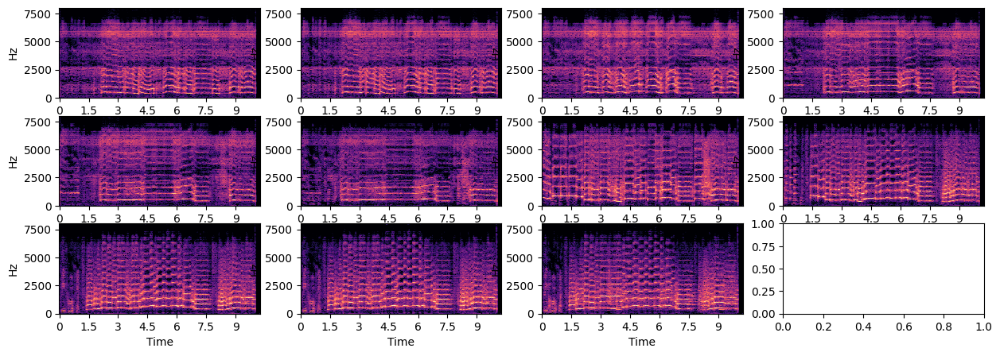

In [25]:
source_text = "A baby sadly crying"
target_text = "A trumpet happily playing"

wavs = []

for i in np.arange(0,1.1,0.1):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i,
                                                   interpolate_terms = ['v'],
                                                   source_selected_word_list=['crying'], source_value_list=[2],
                                                   target_selected_word_list=['happily'], target_value_list=[1]\
                                                   )

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:07<00:00,  2.80it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.43it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.44it/s]


num rows= 1


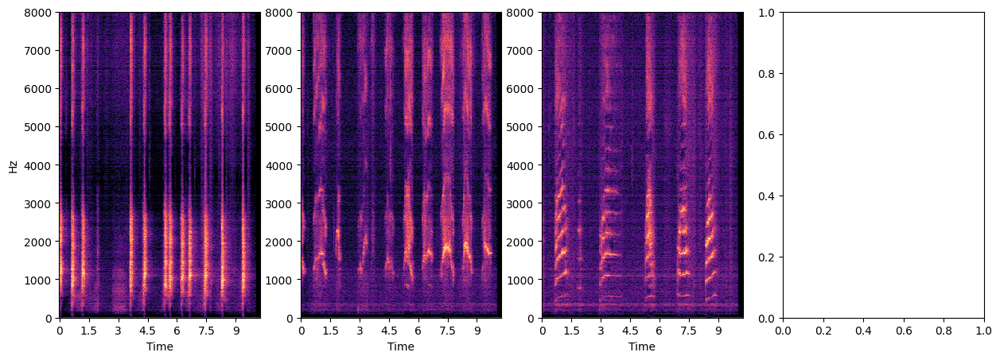

In [17]:
source_text = "A dog barking"
target_text = "A cat meowing"

wavs = []

for i in np.arange(0,1.1,0.5):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=43, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i)

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.28it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.32it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
A baby sadly crying ['crying']
tensor([1., 1., 1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
A trumpet happily playing ['happily']
tensor([1., 1., 1., 1., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2, 3], [4]] torch.Size([6])
A [0]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
A [0]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]
[[0], [1], [2, 3], [4]] [[0], [1], [2], [3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.35it/s]


num rows= 1


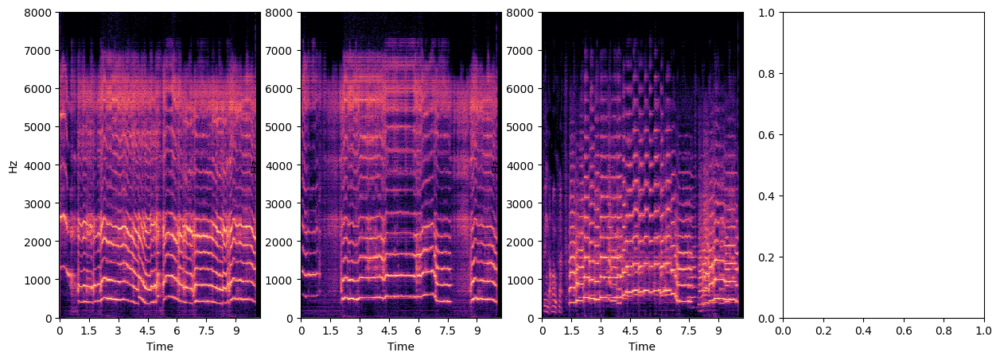

In [22]:
source_text = "A baby sadly crying"
target_text = "A trumpet happily playing"


wavs = []

for interp_val in [0, 0.5, 1.0]:
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = interp_val, 
                                                   source_selected_word_list=['crying'], source_value_list=[2],
                                                   target_selected_word_list=['happily'], target_value_list=[1]\
                                                   )
    
    wavs.append(predicted_wav)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
A baby crying ['crying']
tensor([1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
A trumpet playing ['playing']
tensor([1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:07<00:00,  2.81it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
A baby crying ['crying']
tensor([1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
A trumpet playing ['playing']
tensor([1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.37it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
A baby crying ['crying']
tensor([1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
A trumpet playing ['playing']
tensor([1., 1., 2., 1.], device='cuda:0')
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.39it/s]


num rows= 1


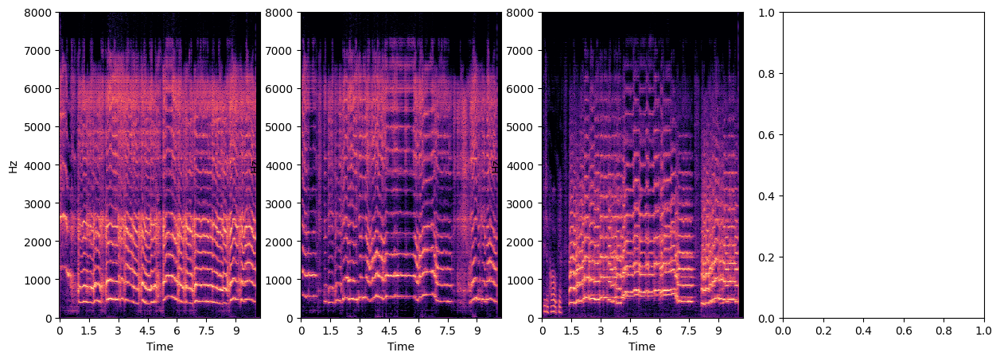

In [17]:
source_text = "A baby crying"
target_text = "A trumpet playing"


wavs = []

for interp_val in [0, 0.5, 1.0]:
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = interp_val, 
                                                   source_selected_word_list=['crying'], source_value_list=[2],
                                                   target_selected_word_list=['playing'], target_value_list=[2]\
                                                   )
    
    wavs.append(predicted_wav)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.37it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.27it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.39it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.41it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.42it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.29it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.41it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.41it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.40it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.45it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
Token for each word in sentence => [[0], [1], [2]] torch.Size([4])
A [0]
[[0], [1], [2]] [[0], [1], [2]]
[[0], [1], [2]] [[0], [1], [2]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.46it/s]


num rows= 3


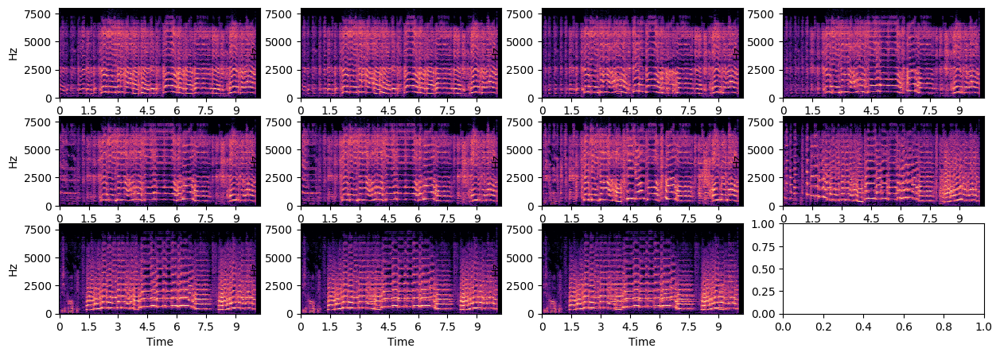

In [21]:
source_text = "A baby crying"
target_text = "A trumpet playing"

wavs = []

for i in np.arange(0,1.1,0.1):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i)

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.39it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.36it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
Token for each word in sentence => [[0], [1], [2, 3]] torch.Size([5])
A [0]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]
[[0], [1], [2, 3]] [[0], [1], [2, 3]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.40it/s]


num rows= 1


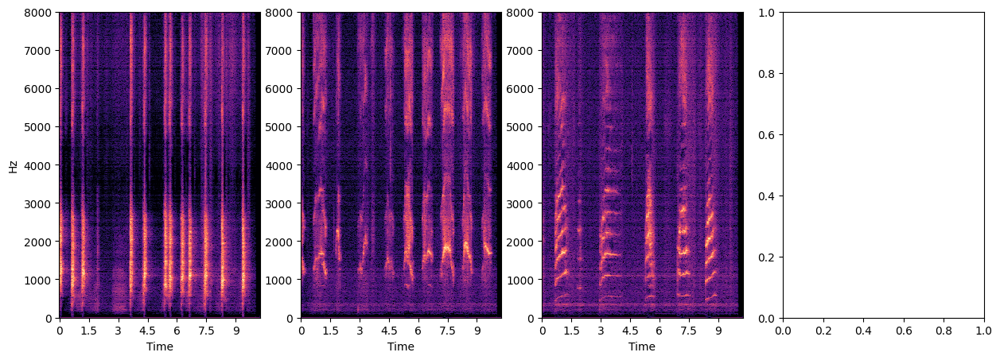

In [18]:
source_text = "A dog barking"
target_text = "A cat meowing"

wavs = []

for i in np.arange(0,1.1,0.5):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=43, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i)

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.26it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.14it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.22it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.25it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.29it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.22it/s]


num rows= 2


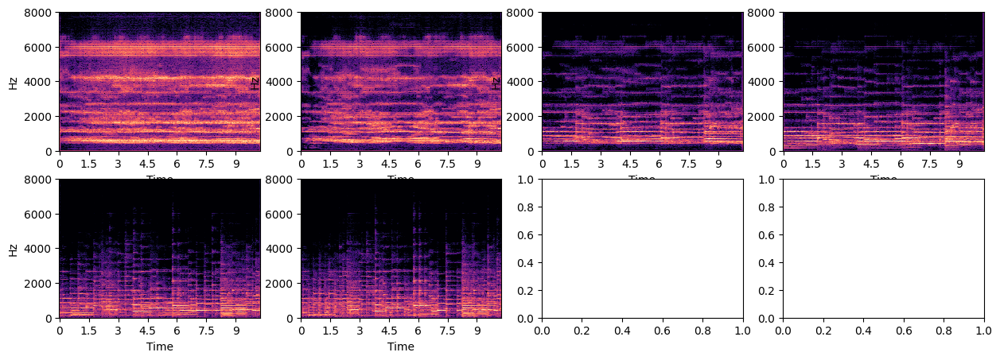

In [27]:
source_text = "An eerie sound made by a ghost"
target_text = "An happy sound made by a piano"

wavs = []

for i in np.arange(0,1.2,0.2):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i)

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.27it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.27it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.24it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.28it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.31it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1, 3], [4], [5], [6], [7, 8], [9]] torch.Size([11])
A [0]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 6], [7]] torch.Size([9])
A [0]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]
[[0], [1, 3], [4], [5], [6], [7, 8], [9]] [[0], [1], [2], [3], [4], [5, 6], [7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.36it/s]


num rows= 2


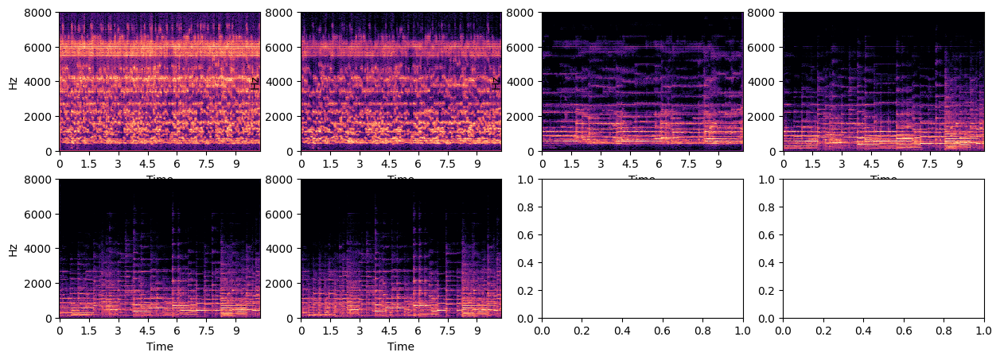

In [28]:
source_text = "An eerie sound made by a ghost"
target_text = "An happy sound made by a piano"

wavs = []

for i in np.arange(0,1.2,0.2):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i,
                                                   interpolate_terms = ['v']
                                                   )

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.04it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.21it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.11it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.09it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.17it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.15it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.16it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.16it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.19it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.14it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
Token for each word in sentence => [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
C [0, 1]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]
[[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]] [[0, 1], [2], [3], [4, 5], [6], [7], [8, 9], [10], [11]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.20it/s]


num rows= 3


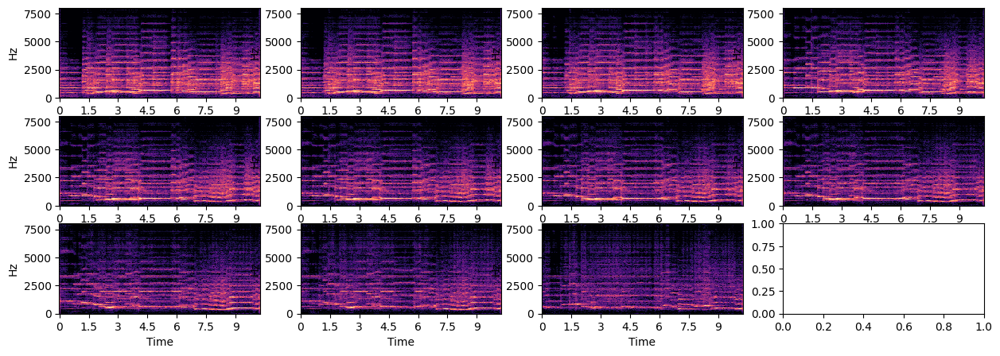

In [34]:
source_text = "Constant pitch of a trumpet in a major scale"
target_text = "Constant pitch of a flute in a major scale"

wavs = []

for i in np.arange(0,1.1,0.1):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i,
                                                   interpolate_terms = ['k','v']
                                                   )

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.49it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4], [5, 7]] torch.Size([9])
a [0, 1]
a dog bark with reverb ['reverb']
tensor([ 1.,  1.,  1.,  1.,  1., -1., -1., -1.,  1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.73it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.81it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4], [5, 7]] torch.Size([9])
a [0, 1]
a dog bark with reverb ['reverb']
tensor([1., 1., 1., 1., 1., 1., 1., 1., 1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.53it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.64it/s]

Token for each word in sentence => [[0, 1], [2], [3], [4], [5, 7]] torch.Size([9])
a [0, 1]
a dog bark with reverb ['reverb']
tensor([1., 1., 1., 1., 1., 3., 3., 3., 1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.76it/s]


num rows= 1


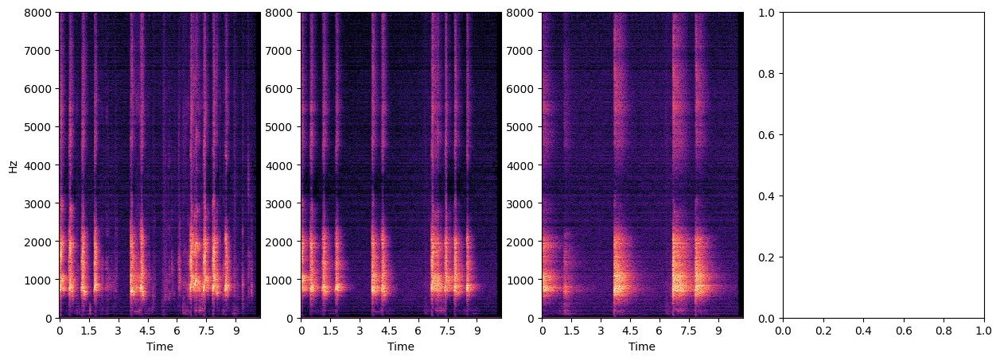

In [42]:
source_text = None
target_text = "a dog bark with reverb"

wavs = []

for i in np.arange(-1,5,2):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=42, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   target_selected_word_list=['reverb'], target_value_list=[i]
                                                   # interpolation_level = i,
                                                   # interpolate_terms = ['k','v']
                                                   )
    
    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.66it/s]

Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 7]] torch.Size([9])
T [0]
The sound of thunder with reverb ['reverb']
tensor([ 1.,  1.,  1.,  1.,  1., -2., -2., -2.,  1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.86it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.88it/s]

Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 7]] torch.Size([9])
T [0]
The sound of thunder with reverb ['reverb']
tensor([ 1.,  1.,  1.,  1.,  1., -1., -1., -1.,  1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.59it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.90it/s]

Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 7]] torch.Size([9])
T [0]
The sound of thunder with reverb ['reverb']
tensor([1., 1., 1., 1., 1., 0., 0., 0., 1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.89it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.76it/s]

Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 7]] torch.Size([9])
T [0]
The sound of thunder with reverb ['reverb']
tensor([1., 1., 1., 1., 1., 1., 1., 1., 1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.49it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   5%|████████                                                                                                                                                         | 1/20 [00:00<00:02,  6.70it/s]

Token for each word in sentence => [[0], [1], [2], [3], [4], [5, 7]] torch.Size([9])
T [0]
The sound of thunder with reverb ['reverb']
tensor([1., 1., 1., 1., 1., 2., 2., 2., 1.], device='cuda:0')


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.01it/s]


num rows= 2


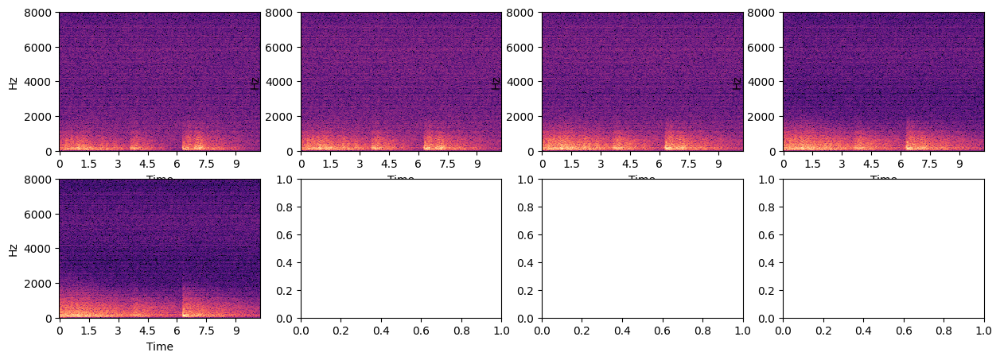

In [44]:
source_text = None
target_text = "The sound of thunder with reverb"

wavs = []

for i in np.arange(-2,3,1):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=42, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   target_selected_word_list=['reverb'], target_value_list=[i]
                                                   # interpolation_level = i,
                                                   # interpolate_terms = ['k','v']
                                                   )
    
    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.23it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  6.82it/s]


num rows= 1


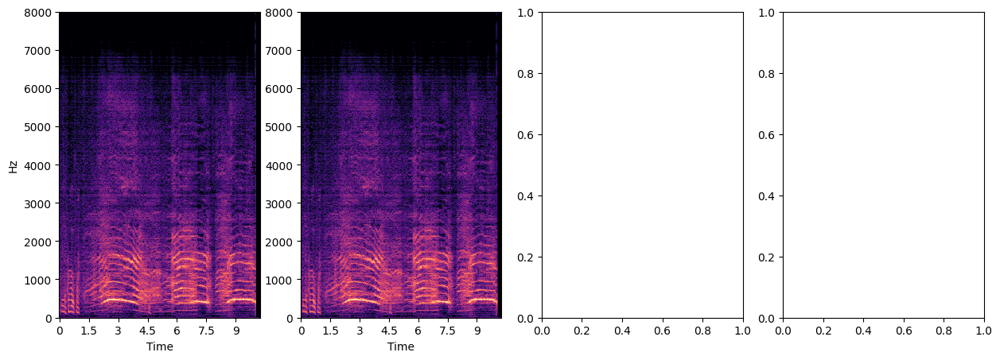

In [53]:
source_text = "The sound of cows mooing"
target_text = "The sound of cat meowing"

wavs = []

for i in np.arange(0,1.1,1):
    predicted_wav = sample_diffusion_attention_edit(source_text=None, target_text=source_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i,
                                                   interpolate_terms = ['q', 'k','v']
                                                   )

    wavs.append(predicted_wav)
    
plot_all(wavs)


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 8]] torch.Size([10])
T [0]
Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 7]] torch.Size([9])
T [0]
[[0], [1], [2], [3, 4], [5], [6, 8]] [[0], [1], [2], [3, 4], [5], [6, 7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.29it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 8]] torch.Size([10])
T [0]
Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 7]] torch.Size([9])
T [0]
[[0], [1], [2], [3, 4], [5], [6, 8]] [[0], [1], [2], [3, 4], [5], [6, 7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.26it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 8]] torch.Size([10])
T [0]
Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 7]] torch.Size([9])
T [0]
[[0], [1], [2], [3, 4], [5], [6, 8]] [[0], [1], [2], [3, 4], [5], [6, 7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.30it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 8]] torch.Size([10])
T [0]
Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 7]] torch.Size([9])
T [0]
[[0], [1], [2], [3, 4], [5], [6, 8]] [[0], [1], [2], [3, 4], [5], [6, 7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.26it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 8]] torch.Size([10])
T [0]
Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 7]] torch.Size([9])
T [0]
[[0], [1], [2], [3, 4], [5], [6, 8]] [[0], [1], [2], [3, 4], [5], [6, 7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:06<00:00,  3.32it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler:   0%|                                                                                                                                                                         | 0/20 [00:00<?, ?it/s]

Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 8]] torch.Size([10])
T [0]
Token for each word in sentence => [[0], [1], [2], [3, 4], [5], [6, 7]] torch.Size([9])
T [0]
[[0], [1], [2], [3, 4], [5], [6, 8]] [[0], [1], [2], [3, 4], [5], [6, 7]]


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:05<00:00,  3.35it/s]


num rows= 2


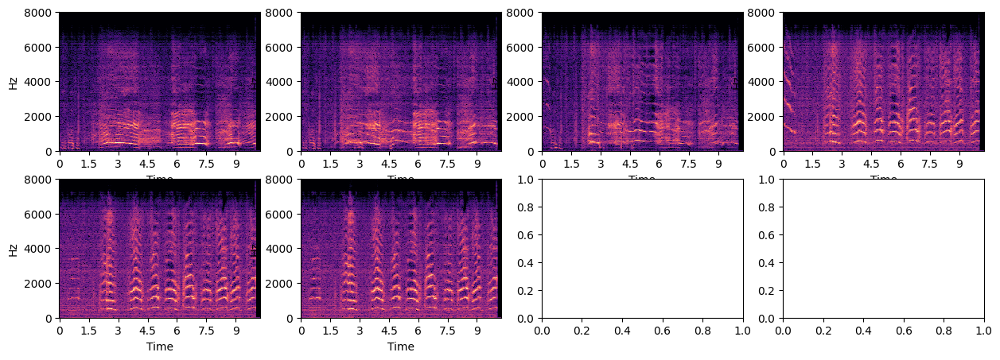

In [24]:
source_text = "The sound of a cow mooing"
target_text = "The sound of a cat mewing"

wavs = []

for i in np.arange(0,1.1,0.2):
    predicted_wav = sample_diffusion_attention_edit(source_text=source_text, target_text=target_text, random_seed=1947, ddim_steps=20,\
                                                   latent_diffusion=latent_diffusion,
                                                   interpolation_level = i,
                                                   interpolate_terms = ['k','v']
                                                   )

    wavs.append(predicted_wav)
    
plot_all(wavs)
